<a href="https://colab.research.google.com/github/supermizar/traffic/blob/master/traffic_prediction_eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 米兰数据探索性分析

## 1. 流量变化直观展示

In [0]:
from matplotlib import pyplot as plt
import numpy as np
%matplotlib inline
train_data = np.load('milan-train.npy')

/usr/local/lib/python3.5/dist-packages/matplotlib/animation.py:973: UserWarning: Animation size has reached 20986781 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
  " will be dropped.".format(self))


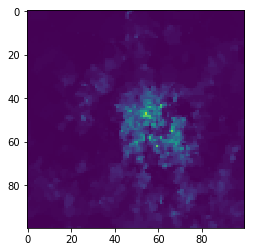

In [31]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc

fig = plt.figure()
# fig.set_size_inches(12, 12)

im = plt.imshow(train_data[0], animated=True)


def updatefig(frame, *args):
    im.set_array(frame)
    return im,
  
ani = animation.FuncAnimation(fig, updatefig, frames=train_data, interval=50, blit=True)

rc('animation', html='jshtml')

ani

## 2. 区别不同活跃度的栅格，分别评估模型的预测性能

(100, 2) (100, 2) (89, 2)


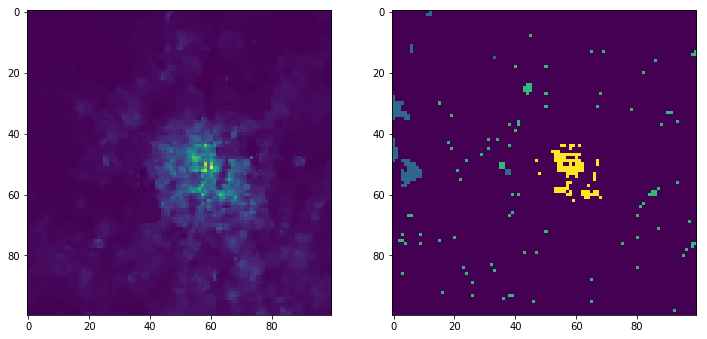

In [37]:
mean_traffic = np.mean(train_data, axis=0)
active_coord = np.argwhere(mean_traffic > np.percentile(mean_traffic, 99))
common_coord = np.argwhere((mean_traffic > np.percentile(mean_traffic, 49.5)) & (mean_traffic < np.percentile(mean_traffic, 50.5)))
inactive_coord = np.argwhere(mean_traffic < np.percentile(mean_traffic, 1))
print(active_coord.shape, common_coord.shape, inactive_coord.shape)
mat = np.zeros((100, 100))
for c in active_coord:
    mat[c[0], c[1]] = 300
for c in common_coord:
    mat[c[0], c[1]] = 200
for c in inactive_coord:
    mat[c[0], c[1]] = 100
fig, axes = plt.subplots(1, 2)
fig.set_size_inches(12, 6)
axes[0].imshow(mean_traffic)
axes[1].imshow(mat)

右图黄色代表最活跃的前1%的区域，绿色为普通活跃的1%，蓝色为最不活跃的1%

**AI平台实验，结果：**

流量预测-趋势加周期-**活跃区域**预测	 NRMSE稳定在0.50左右，最低0.45

流量预测-趋势加周期-**普通区域**预测	       NRMSE稳定在0.6左右，最低0.57

流量预测-趋势加周期-**不活跃区域**预测    NRMSE稳定在3.0左右，最低1.45

规律非常明显：活跃区域的预测性能（NRMSE）更好

## 3. 评估不同模型的预测性能